# Data

In [1]:
import sys 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import seaborn as sns
from scipy.stats import poisson  
from scipy.integrate import odeint

%matplotlib inline
%config InlineBackend.figure_format = 'svg'
plt.rcParams.update({'font.size': 7, 'font.style': 'normal', 'font.family':'serif'})

For each region, we apply the model separately.

In [2]:
region = "MI"

From now on, the code is specifically for the region noted above.

In [3]:
info = pd.read_excel('useless_stuff.xlsx')
data = pd.read_csv('data_provinces.csv').drop('Unnamed: 0', axis = 1)
final_data = pd.DataFrame(data[region]).rename(columns={region: "n_cases"})
final_data['cum_cases'] = np.cumsum(data[region])
full_data = final_data
final_data = final_data[:info[region][1]]

In [4]:
info #contains population of regions and dates used for calibrating the model

,Unnamed: 0,LO,PV,SO,MN,MI,CO,BS,MB,LC,CR,BG,VA
0,population,44928,71882,21477,48835,1406242,85543,196340,124840,48058,72399,120783,80724
1,dates,64,68,74,74,68,68,68,68,70,66,66,73


Showing graphs of the infection status

Text(0.5, 0.98, 'MI')

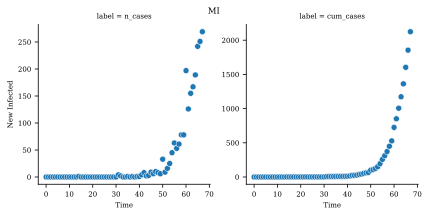

In [5]:
D = final_data.iloc[:,0:].stack().reset_index()
D.columns = ['time_step', 'label', 'value']

g = sns.FacetGrid(D, col="label", height=3, col_wrap=2, sharey= False) #plots of daily and cumulative cases for specified region
g.map(sns.scatterplot, "time_step", 'value')
g.set_axis_labels("Time", "New Infected");
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle(region)

# Exercise 1

Methods that will be used throughout this notebook for calibration.

In [6]:
def SEIR_eq(INPUT,t, beta, alpha, gamma, b,m): #SEIR Model defined with differential equations
    S, E, I, R = INPUT
    N = S + E + I + R
            
    dS_dt =  b*N - (beta * S * (I/N))  - m*S
    dE_dt = (beta * S * (I/N)) - (alpha * E) - m*E
    dI_dt = alpha*E - gamma*I - m*I
    dR_dt = (gamma * I) - m*R
    return dS_dt, dE_dt, dI_dt, dR_dt


def compute_likelihood(data, data_hat): #likelihood computation for MLE
    lkh = 1
    for i in range(len(data)-1):
        lkh = lkh * poisson.pmf(data[i],data_hat[i]) #poisson likelihood to observe the data with a model
        if str(lkh) == 'nan':
            lkh = 0
            break
    return lkh


def compute_loglikelihood(data, data_hat): #maximizion log-likelihood is similar to maximizing likelihood, but more convenient
    llkh = 0
    for i in range(len(data)-1):
        llkh = llkh + np.log(poisson.pmf(data[i],data_hat[i])) #poisson likelihood to observe the data with a model
    return llkh


def metropolis_hastings(iterations, beta_start,gamma, b, m, std, true_data): #Metropolis hastings algorihm is a MCMC method that is used for optimization
    
    RES = odeint(SIR_eq, y0, t, args=(beta_start, gamma, b, m))
    I_hat, R = RES.T[1:]
    I_daily = (I_hat[1:]+R[1:])-(I_hat[:-1]+R[:-1])
    llkh_start = compute_loglikelihood(true_data, I_daily)
    
    
    BETAS =[beta_start]
    llkh = [llkh_start]
    
    for ITER in range(iterations):
    
        beta_current = BETAS[-1]
        llkh_current = llkh[-1]

        beta_new = np.random.normal(beta_current, std, size = 1)
        RES = odeint(SIR_eq, y0, t, args=(beta_new, gamma, b, m))
        I_hat, R = RES.T[1:]

        I_daily = (I_hat[1:]+R[1:])-(I_hat[:-1]+R[:-1])
        llkh_new = compute_loglikelihood(true_data, I_daily)

        alpha = np.e**(llkh_new - llkh_current)

        if alpha <= np.random.uniform(0,1): 
            BETAS.append(beta_current)
            llkh.append(llkh_current)

        else: 
            BETAS.append(beta_new)
            llkh.append(llkh_new)
      

    BETAS = BETAS[400:]  #first 400 iterations are discarded
    llkh = llkh[400:]
    
    return np.array(BETAS).flatten(), np.array(llkh).flatten()

Defining variables

In [7]:
# time variables: 
ndays = len(final_data.cum_cases)
t = np.arange(1, ndays+1, 1)# initial population
N=info[region][0]
y0 = N-1 , 0, 1, 0

# parameters
d = 6 #average infectious period; number of days before recovery (gamma = 1/d)
m = 1/(83.6*365) #average mortality rate in Lombardia
b = m #birth rate is set equal to mortality rate
gamma= 1/d

count_increase = 0.01 #iteration counter

R0s = np.arange(1, 4, count_increase) #trying R0s in a range from 1 to 4
alphas = np.arange(0, 1, count_increase) #trying alphas in a range from 0 to 1

Finding optimal R0 for the specific region

In [8]:
MSEs = []  # store all MSEs
I_hats = [] # store all the I_daily of the model that you test

# MLE log_like
llkhs = []
lkhs = []
I_hats = []

for alpha in alphas: #iterating through alphas and R0s
    for R0 in R0s:
        beta = (R0*(alpha+b)*(b+gamma))/alpha

        # Run the model over time 
        RES = odeint(SEIR_eq, y0, t, args=(beta, alpha, gamma, b, m))
        S, E, I_hat, R = RES.T

        I_daily = (I_hat[1:]+R[1:])-(I_hat[:-1]+R[:-1])
        I_hats.append(I_daily)
        true_data = final_data.n_cases[:len(I_daily)]

        MSE = np.sqrt(sum((I_daily-true_data)**2)/len(true_data))
        MSEs.append(MSE)

        #compute likelihood and loglikelihood 
        llkhs.append(compute_loglikelihood(final_data.n_cases,I_daily))
        lkhs.append(compute_likelihood(final_data.n_cases,I_daily))

long_R0s = R0s #done to append R0 to match correct MSE
for i in range(1, len(alphas)):
    long_R0s = np.append(long_R0s, R0s)
    

count = 0-count_increase
long_alphas = [] #done to append alphas to match correct MSE
for i in range(0, len(MSEs)):
    if (len(long_alphas)%len(R0s)==0):
        count+=count_increase
                
    long_alphas = np.append(long_alphas, [count])
    
cal = pd.DataFrame({'R0': long_R0s, 'alpha': long_alphas, 'MSE': MSEs, 'lkh': lkhs, 'llkh': llkhs, 'I_hat': I_hats})

<ipython-input-8-26c3d3819eff>:11: RuntimeWarning: divide by zero encountered in double_scalars
  beta = (R0*(alpha+b)*(b+gamma))/alpha
/Users/louislacombe/opt/anaconda3/lib/python3.8/site-packages/scipy/integrate/odepack.py:247: ODEintWarning: Illegal input detected (internal error). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
<ipython-input-6-7604f3c61136>:25: RuntimeWarning: divide by zero encountered in log
  llkh = llkh + np.log(poisson.pmf(data[i],data_hat[i])) #poisson likelihood to observe the data with a model


Choosing according to lowest MSE:

In [9]:
#Graph of optimized R0 and alpha according to MSE
sns.set_theme()
sns.set_context("paper")
sns.set_style('whitegrid')
sns.set_palette('Greens')
sns.color_palette("flare", as_cmap=True)

best_modelMSE = cal.loc[cal['MSE'].idxmin()]
print(region + ' Best Model {}: \n RO: {}, Alpha: {}'.format(round(best_modelMSE['MSE'],2), round(best_modelMSE['R0'], 4), round(best_modelMSE['alpha'], 4)))

R0_used = best_modelMSE['R0']
alpha_used = best_modelMSE['alpha']

fig, axs = plt.subplots(2, facecolor='w', figsize=(7,4))
axs[0].set_title(region + ' Best Model {}: \n RO: {}, Alpha: {}'.format(round(best_modelMSE['MSE'],2), round(best_modelMSE['R0'], 4), round(best_modelMSE['alpha'], 4), fontsize=10))
axs[0].scatter(t, final_data.n_cases, color = 'xkcd:carolina blue', label = 'Daily Infections: Actual', marker = 'o')
axs[0].plot(t[:-1] ,best_modelMSE['I_hat'], alpha=1, lw=2, label='Daily Infections: Simulated', color = 'xkcd:kermit green')

axs[1].set_title('MSEs & R0s', fontsize=10)
axs[1].scatter(cal['R0'], cal['MSE'], color = 'tab:gray' , s =0.2 )
axs[1].axvline(x= best_modelMSE['R0'], ymin=0, ymax=2, c= 'b')
axs[1].scatter(best_modelMSE['R0'], best_modelMSE['MSE'], color = 'xkcd:brick red' ,marker = 'x', s =50, label='min MSE')

axs[1].set_xlabel('R0s')
axs[1].set_ylabel('MSEs')


for i in range(2):
    axs[i].legend(fancybox = True)
    for spine in ('top', 'right'): 
        axs[i].spines[spine].set_visible(False)



fig.tight_layout()
# fig.show()

MI Best Model 15.44: 
 RO: 3.83, Alpha: 0.09


Choosing according to highest likelihood:

MI BEST MODEL: llkh:-313.64, RO: 3.77, Alpha: 0.09


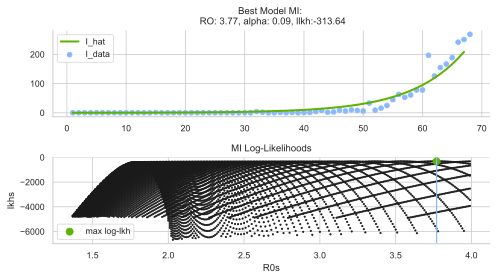

In [10]:
#Graph of optimized R0 and alpha according to MLE
sns.set_theme()
sns.set_context("paper")
sns.set_style('whitegrid')
sns.set_palette('Greens')
sns.color_palette("flare", as_cmap=True)


best_modelLLKH = cal.loc[cal['llkh'].idxmax()]
print(region + ' BEST MODEL: llkh:{}, RO: {}, Alpha: {}'.format(round(best_modelLLKH['llkh'],2), round(best_modelLLKH['R0'], 4), round(best_modelLLKH['alpha'], 4)))

fig, axs = plt.subplots(2, facecolor='w', figsize=(7,4))
axs[0].set_title('Best Model {}: \n RO: {}, alpha: {}, llkh:{}'.format(region, round(best_modelLLKH['R0'], 2), round(best_modelLLKH['alpha'], 4), round(best_modelLLKH['llkh'],2)))
#axs[0,0].scatter(t, data.cum_cases, color = 'b', label = 'I_data')
axs[0].scatter(t, final_data.n_cases, color = 'xkcd:carolina blue', label = 'I_data')

axs[0].plot(t[:-1] ,best_modelLLKH['I_hat'], alpha=1, lw=2, label='I_hat', color = 'xkcd:kermit green')

axs[1].set_title(region + ' Log-Likelihoods')
axs[1].scatter(cal['R0'], cal['llkh'], color = 'k' , s =2 )
axs[1].scatter(best_modelLLKH['R0'], best_modelLLKH['llkh'], color = 'xkcd:kermit green' , s =50, label='max log-lkh' )
axs[1].axvline(x = best_modelLLKH['R0'], ymin=0, ymax=2, c= 'xkcd:carolina blue')

axs[1].set_xlabel('R0s')
axs[1].set_ylabel('lkhs')

for i in range(2):
    axs[i].legend(fancybox = True)
    for spine in ('top', 'right'): 
        axs[i].spines[spine].set_visible(False)

fig.tight_layout()
# fig.show()

Plotting over the full values...

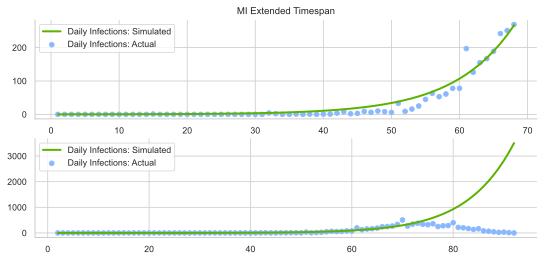

In [11]:
#Graph of fitted model to data but for extended time period to see that real cases stopped rising exponentially

ndays = len(full_data.cum_cases)
t = np.arange(1, ndays+1, 1)# initial population
N=info[region][0]
y0 = N-1 , 0, 1, 0

# parameters
d = 6 #average infectious period; number of days before recovery (recall : gamma = 1/d)
m = 1/(83.6*365)
b = m
gamma= 1/d

R0 = R0_used
alpha = alpha_used
beta = (R0*(alpha+b)*(b+gamma))/alpha

# Run the model over time 
RES = odeint(SEIR_eq, y0, t, args=(beta, alpha, gamma, b, m))
S, E, I_hat, R = RES.T
I_daily = (I_hat[1:]+R[1:])-(I_hat[:-1]+R[:-1])

sns.set_theme()
sns.set_context("paper")
sns.set_style('whitegrid')
sns.set_palette('Greens')
sns.color_palette("flare", as_cmap=True)

fig, axs = plt.subplots(2, facecolor='w', figsize=(9,4))
axs[0].set_title(region + ' Extended Timespan')
# axs[0,0].set_title('Best Model: RO: {}, lkh:{}'.format(round(best_model['R0'], 2), round(best_model['lkh'],2)))
axs[0].scatter(t[:68], full_data.n_cases[:68], color = 'xkcd:carolina blue', label = 'Daily Infections: Actual')
axs[0].plot(t[:68] ,I_daily[:68], alpha=1, lw=2, label='Daily Infections: Simulated', color = 'xkcd:kermit green')

axs[1].scatter(t[1:], full_data.n_cases[1:], color = 'xkcd:carolina blue', label = 'Daily Infections: Actual', marker = 'o')
axs[1].plot(t[1:],I_daily, alpha=1, lw=2, label='Daily Infections: Simulated', color = 'xkcd:kermit green')

for i in range(2):
    axs[i].legend(fancybox = True)
    for spine in ('top', 'right'): 
        axs[i].spines[spine].set_visible(False)

# Data

In [12]:
import sys 
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import seaborn as sns
from scipy.stats import poisson  
from scipy.integrate import odeint

%matplotlib inline
%config InlineBackend.figure_format = 'svg'
plt.rcParams.update({'font.size': 7, 'font.style': 'normal', 'font.family':'serif'})

For each region, we apply the model separately

In [13]:
region = "MI"

From now on, the code is specifically for the region noted above...

In [14]:
info = pd.read_excel('useless_stuff.xlsx')
data = pd.read_csv('data_provinces.csv').drop('Unnamed: 0', axis = 1)
final_data = pd.DataFrame(data[region]).rename(columns={region: "n_cases"})
final_data['cum_cases'] = np.cumsum(data[region])
full_data = final_data
final_data = final_data[:info[region][1]]

# Exercise 2

For exercise 2, we want to do a age stratified simulation, this means that we want to simulate each age group separately. For this we will make use of the contact matrix between each age group.

In [15]:
prop_pol = pd.read_excel('prop_pop.xlsx')
n = np.array(prop_pol['prop']) #proportions of age in Milan

# time variables: 
ndays = len(final_data.cum_cases) #we train the model up until day 68
t = np.arange(1, ndays+1, 1)
N=info[region][0] #initial population

# parameters
d = 6 #average infectious period; number of days before recovery
gamma = 1/d
m = 1/(83.6*365) #this is an estimation of the birth rate
b = m # we set the birth rate equal to the mortality rate

# infected = np.array([0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0]) #this is who we infect in our initial population
infected = np.array([1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]) #this is who we infect in our initial population


S = ((N*n)-infected) #our susceptibles is the initial population - the one that has been infected
I = infected
R = np.array([0]*len(S)) #no recovered for the moment
INPUT = np.hstack((S,I,R))/N #we want all those values as proportions

R0s = np.arange(1, 4, 0.01) #We test Ro from 1 to 4 by 0.001 increase.

c = np.matrix(pd.read_csv('italian_matrix.csv').drop('Unnamed: 0', axis = 1)) #this is the contact matrix
dominant_eigen_c = max(np.real(np.linalg.eigvals(np.squeeze(np.asarray(c))*n)))

This is the SIR model we wil be using, it includes demographics.

In [16]:
def SIR_ex_eq(INPUT,t, BETA, gamma, b, m):
    Y=np.zeros((48))
    V = INPUT
    k= 16
    for i in range(k):
        SUM = np.dot(BETA[i], V[k:k*2]) * V[i]
        Y[i] = b*n[i] - SUM - m*V[i]
        Y[(k+i)] = SUM - m  * V[(k+i)] - gamma  * V[(k+i)]
        Y[(2*k+i)] = gamma*m*V[(k+i)]   - m * V[(2*k+i)]
    return Y

In [17]:
MSEs = []  # store all MSEs
I_hats = [] # store all the I_daily of the model that you test

for R0 in R0s:
    beta= R0*gamma/dominant_eigen_c
    BETA = beta*c

    RES = odeint(SIR_ex_eq, INPUT ,t, args=(BETA, gamma, b, m))    
    S_ = RES.T[:16,:]*N
    I_ = RES.T[16:32,:]*N
    R_ = RES.T[32:,:]*N
    
    S_sum = S_.sum(axis=0)  
    I_sum = I_.sum(axis=0)
    R_sum = R_.sum(axis=0)
    
    I_daily = (I_sum[1:]+R_sum[1:])-(I_sum[:-1]+R_sum[:-1])
    I_hats.append(I_daily)
    true_data = final_data.n_cases[:len(I_daily)]
    
    MSE = np.sqrt(sum((I_daily-true_data)**2)/len(true_data))
    MSEs.append(MSE)

cal = pd.DataFrame({'R0': R0s, 'MSE': MSEs, 'I_hat': I_hats})

Getting the best model according to the lowest MSE

BEST MODEL: MSE:25.38, RO: 1.47


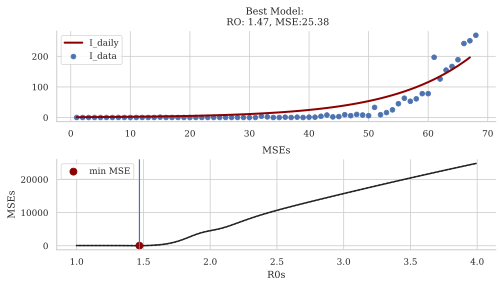

In [18]:
best_model = cal.loc[cal['MSE'].idxmin()]
print('BEST MODEL: MSE:{}, RO: {}'.format(round(best_model['MSE'],2), round(best_model['R0'], 4)))

R0_ex2 = best_model['R0'] #we save this R0 for exercise 3

fig, axs = plt.subplots(2, facecolor='w', figsize=(7,4))
axs[0].set_title('Best Model: \n RO: {}, MSE:{}'.format(round(best_model['R0'], 2), round(best_model['MSE'],2)))
axs[0].scatter(t, final_data.n_cases, color = 'b', label = 'I_data')
axs[0].plot(t[:-1] ,best_model['I_hat'], alpha=1, lw=2, label='I_daily', color = 'darkred')
    
axs[1].set_title('MSEs')
axs[1].scatter(cal['R0'], cal['MSE'], color = 'k' , s =1 )
axs[1].scatter(best_model['R0'], best_model['MSE'], color = 'darkred' , s =50, label='min MSE')
axs[1].axvline(x= best_model['R0'], ymin=0, ymax=2, c= 'b')
axs[1].set_xlabel('R0s')
axs[1].set_ylabel('MSEs')

for i in range(2):
    axs[i].legend(fancybox = True)
    for spine in ('top', 'right'): 
        axs[i].spines[spine].set_visible(False)
        
fig.tight_layout()

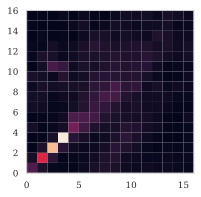

In [19]:
fig, ax = plt.subplots(1, 1, figsize=(3,3))
ax.pcolor(np.array(c*beta))
plt.show()

Now we run the simulation with the best R0 and more days in order to see what happens once we optimized it for the first 68 days.

In [20]:
ndays = 200 
ndays = len(full_data.cum_cases) #we train the model up until day 68

t = np.arange(1, ndays+1, 1)# initial population

R0 = R0_ex2
beta = R0*gamma/dominant_eigen_c
BETA = beta*c

# Run the model over time 
RES = odeint(SIR_ex_eq, INPUT ,t, args=(BETA, gamma, b, m))
    
S_ = RES.T[:16,:]*N
I_ = RES.T[16:32,:]*N
R_ = RES.T[32:,:]*N

I_daily = pd.DataFrame((I_.T[1:]+R_.T[1:])-(I_.T[:-1]+R_.T[:-1]))

Text(0.5, 0.98, 'SIR model with age stratification')

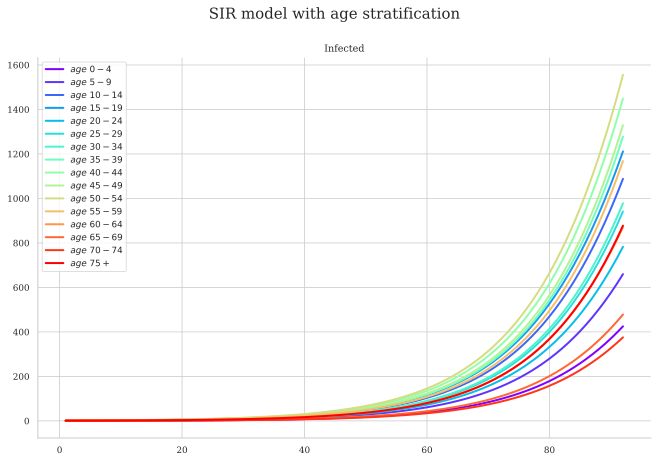

In [21]:
import matplotlib.cm as cm
from cycler import cycler

fig, axs = plt.subplots(1, facecolor='w', figsize=(11,7))

evenly_spaced_interval = np.linspace(0, 1, 16)
colors = [cm.rainbow(x) for x in evenly_spaced_interval]

for i in range(16):
    axs.set_title('Infected')
    axs.plot(t, np.array(I_[i]), c = colors[i], lw=2,label='$age$ ${i}$'.format(i=prop_pol['age'][i]))
    axs.legend(fancybox = True)
    for spine in ('top', 'right'): 
        axs.spines[spine].set_visible(False)
    

fig.suptitle('SIR model with age stratification', fontsize=15)

Text(0.5, 0.98, 'SIR model with age stratification proportioned')

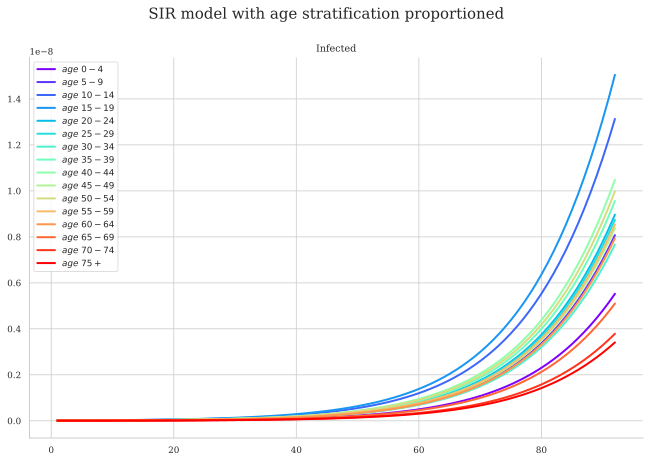

In [22]:
import matplotlib.cm as cm
from cycler import cycler

fig, axs = plt.subplots(1, facecolor='w', figsize=(11,7))

evenly_spaced_interval = np.linspace(0, 1, 16)
colors = [cm.rainbow(x) for x in evenly_spaced_interval]

N_ = np.zeros((16,92))

for i in range(16):
    N_[i] = S_[i] + I_[i] + R_[i]


prop_per_age_inf = (I_/N)/N_
    

for i in range(16):
    axs.set_title('Infected')
    axs.plot(t, np.array(prop_per_age_inf[i]), c = colors[i], lw=2,label='$age$ ${i}$'.format(i=prop_pol['age'][i]))
    axs.legend(fancybox = True)
    for spine in ('top', 'right'): 
        axs.spines[spine].set_visible(False)
    

fig.suptitle('SIR model with age stratification proportioned', fontsize=15)

# Exercise 3 (stochasticity)

Here we setup the functions we will be using for third exercise

In [23]:
def computeTransitions(popoulation_at_risk, event_rate, time_step):
    p = event_rate * time_step
    n_of_events = np.random.binomial(popoulation_at_risk, p, 1) #checking how many people out of the population actually get covid when they come in contact
    return(n_of_events)

def SIR(S0,I0,R0, transmission_rate , recovery_rate, ndays , steps_per_day):    
    time_step = 1/steps_per_day 
    t = np.arange(0, ndays, time_step)
        
    S = np.zeros((len(t),16)) #creating the matrix for all susceptible over timeframe
    I = np.zeros((len(t),16)) #creating the matrix for all infected over timeframe
    R = np.zeros((len(t),16)) #creating the matrix for all recovered over timeframe  
    S[0] = S0 #setting initial row
    I[0] = I0
    R[0] = R0
    
    for i in range(1, len(t)): #we go through each t for the iterations
        beta = np.dot(I[i-1]/N,BETA) #we calculate this before so we only have to do it once per iteration of 
        for j in range(len(c)): #we go through each age group
            lambda_ = (beta[0,j]) #we pick the beta for our specific age group
                   
            #Setting the parameters we will use as restrictive measures
            
            nothing = 1
            new_infections1 = 0
            
            masks = 0.85
            mask_intro = 20
            new_infections2 = 0
            
            closing_schools = 0.25
            school_intro = 60
            new_infections3 = 0
            
            isolate_old = 0.25
            old_intro = 30
            new_infections4 = 0
            
            full_lockdown = 0.40
            lockdown_intro = 9000000
            new_infections5 = 0
            
            if t[i]<mask_intro:
                if (lambda_ > 0) & (S[i-1][j]>0):
                    new_infections1 = computeTransitions(S[i-1][j],lambda_,time_step)
                elif (lambda_<=0) | (S[i-1][j]<=0):
                    new_infections1=0
            elif (t[i]>school_intro) & ((j==2) | (j==3) | (j==4)):
                if ((lambda_ > 0) & (S[i-1][j]>0)):
                        new_infections3 = computeTransitions(S[i-1][j],lambda_*closing_schools*masks,time_step)
                elif (lambda_<=0) | (S[i-1][j]<=0):
                        new_infections3=0           
            elif (t[i]>old_intro) & ((j==13) | (j==14) | (j==15)):
                if ((lambda_ > 0) & (S[i-1][j]>0)):
                        new_infections4 = computeTransitions(S[i-1][j],lambda_*isolate_old*masks,time_step)
                elif (lambda_<=0) | (S[i-1][j]<=0):
                        new_infections4=0   
            elif (t[i]>lockdown_intro):
                if ((lambda_ > 0) & (S[i-1][j]>0)):
                        new_infections5 = computeTransitions(S[i-1][j],lambda_*full_lockdown*masks,time_step)
                elif (lambda_<=0) | (S[i-1][j]<=0):
                        new_infections5=0 
            else:
                if (lambda_ > 0) & (S[i-1][j]>0):
                    new_infections2 = computeTransitions(S[i-1][j],lambda_*masks,time_step)
                elif (lambda_<=0) | (S[i-1][j]<=0):
                    new_infections2=0
                    
                    
            
                        
            total_infections = new_infections1 + new_infections2 + new_infections3 + new_infections4 + new_infections5
            
            # new recoveries are possible only if I>0
            if(I[i-1][j]>0):
                new_recoveries = computeTransitions(I[i-1][j],gamma,time_step)
            else:
                new_recoveries=0

            # control that new infections do not exceed available susceptibles
            if(total_infections > S[i-1][j]):
                    total_infections = S[i-1][j]

            # control that new recoveries do not exceed available infected individuals
            if(new_recoveries>I[i-1][j]):
                new_recoveries = I[i-1][j]
            
            
            #Updating our matrix
            S[i][j] = S[i-1][j] - total_infections  + b*S[i-1][j] 
            I[i][j] = I[i-1][j] + total_infections - new_recoveries - b*I[i-1][j]
            R[i][j] = R[i-1][j] + new_recoveries - b*I[i-1][j]

    dS_dt = S
    dI_dt = I
    dR_dt = R
    return dS_dt, dI_dt, dR_dt


Which measure:

In [24]:
which_measure = "Measure1&2&3"

We will re-introduce all the data to make sure there are no changes made due to previous manipulations.

In [25]:
region = "MI"
info = pd.read_excel('useless_stuff.xlsx')
data = pd.read_csv('data_provinces.csv').drop('Unnamed: 0', axis = 1)
final_data = pd.DataFrame(data[region]).rename(columns={region: "n_cases"})
final_data['cum_cases'] = np.cumsum(data[region])
full_data = final_data
final_data = final_data[:info[region][1]]
prop_pol = pd.read_excel('prop_pop.xlsx')
n = np.array(pd.read_excel('prop_pop.xlsx')['prop'])
c = np.matrix(pd.read_csv('italian_matrix.csv').drop('Unnamed: 0', axis = 1))
dominant_eigen_c = max(np.real(np.linalg.eigvals(np.squeeze(np.asarray(c))*n)))


# time variables: 
ndays = 200 #this may be changed to personal will
t = np.arange(1, ndays+1, 1)# initial population
steps_per_day = 10

# parameters
N=info[region][0]
d = 6
gamma = 1/d
m = 1/(83.6*365*100) #we had an issue with this model if the birth rate was too high, hence we lowered it
b = m
beta = R0_ex2*gamma/dominant_eigen_c #we use the R0 optimized in exercise 2
BETA = beta*c

infected = np.array([1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]) #this is who we infect in our initial population
S0 = ((N*n)-infected)
I0 = infected
R0 = np.array([0]*len(S0))

Here we run the simulation in order to get the mean and standard deviations

In [26]:
nsim=10
Ss = []
Is= []
Rs = []
for isim in range(1,nsim+1):
    sys.stdout.write('\rSimulation n°: {}'.format(isim))
    S,I,R = SIR(S0,I0,R0, gamma, BETA, ndays, steps_per_day)
    Ss.append(S)
    Is.append(I)
    Rs.append(R)
print('\nDone!')   

Simulation n°: 10
Done!


We calculate all the means:

In [27]:
meanS = pd.DataFrame(np.mean(Ss, axis=0))
meanI = pd.DataFrame(np.mean(Is, axis=0))
meanR = pd.DataFrame(np.mean(Rs, axis=0))

sdS = pd.DataFrame(np.std(Ss, axis=0, dtype=np.float64))
sdI = pd.DataFrame(np.std(Is, axis=0, dtype=np.float64))
sdR = pd.DataFrame(np.std(Rs, axis=0, dtype=np.float64))

In [28]:
t = np.arange(0, ndays, 1/steps_per_day)
fig, axs = plt.subplots(1, facecolor='w', figsize=(11, 7))

evenly_spaced_interval = np.linspace(0, 1, 16)
colors = [cm.rainbow(x) for x in evenly_spaced_interval]
  
for i in range(16):
    axs.set_title('All ages mean and sd for susceptible, infected and recovered')
    axs.plot(t, np.array(meanS[i]), c = 'darkblue', lw=2, label = 'mean S')
    axs.plot(t, np.array(meanI[i]), c = 'darkred', lw=2, label = 'mean I')
    axs.plot(t, np.array(meanR[i]), c = 'darkgreen', lw=2, label = 'mean R')
    axs.fill_between(t, np.array(meanS[i])+np.array(sdS[i]), np.array(meanS[i])-np.array(sdS[i]), facecolor='blue', alpha=0.1)
    axs.fill_between(t, np.array(meanI[i])+np.array(sdI[i]), np.array(meanI[i])-np.array(sdI[i]), facecolor='r', alpha=0.1)
    axs.fill_between(t, np.array(meanR[i])+np.array(sdR[i]), np.array(meanR[i])-np.array(sdR[i]), facecolor='g', alpha=0.1)
    
    
fig.suptitle("SIR model: "+which_measure, fontsize=15)

Text(0.5, 0.98, 'SIR model: Measure1&2&3')

In [29]:
import matplotlib.cm as cm
from cycler import cycler

t = np.arange(0, ndays, 1/steps_per_day)
fig, axs = plt.subplots(1,3, facecolor='w', figsize=(20,7))

evenly_spaced_interval = np.linspace(0, 1, 16)
colors = [cm.rainbow(x) for x in evenly_spaced_interval]
  
for i in range(16):
    axs[0].set_title('Susceptible')
    axs[0].plot(t, np.array(meanS[i]), c = colors[i], lw=2,label='$age$ ${i}$'.format(i=prop_pol['age'][i]))
    axs[0].fill_between(t, np.array(meanS[i])+np.array(sdS[i]), np.array(meanS[i])-np.array(sdS[i]), alpha=0.1)
#     axs[0].legend(fancybox = True)
    
    
    axs[1].set_title('Infected')
    axs[1].plot(t, np.array(meanI[i]), c = colors[i], lw=2)
    axs[1].fill_between(t, np.array(meanI[i])+np.array(sdI[i]), np.array(meanI[i])-np.array(sdI[i]), alpha=0.1)
#     axs[1].legend(fancybox = True)
    
    axs[2].set_title('Recovered')
    axs[2].plot(t, np.array(meanR[i]), c = colors[i], lw=2)
    axs[2].fill_between(t, np.array(meanR[i])+np.array(sdR[i]), np.array(meanR[i])-np.array(sdR[i]), alpha=0.1)
#     axs[2].legend(fancybox = True)

    
for i in range(3):
    #axs[i].legend(fancybox = True)
    for spine in ('top', 'right'): 
        axs[i].spines[spine].set_visible(False)
        

fig.legend(loc = 'center right')        
fig.suptitle("Restrictive measure for Milano: "+which_measure+", n. of days:"+str(ndays), fontsize=15)

Text(0.5, 0.98, 'Restrictive measure for Milano: Measure1&2&3, n. of days:200')